In [25]:
import pandas as pd
import numpy as np
import pickle
from src.constants import *
from src.neuron import *
from src.utils import *
from src.network import *
from src.validation import *
from src.viz import *
from src.genetic_algorithm import *
from multiprocessing import Pool
from functools import partial
import ast

min_score = 730

In [4]:
# From single run

pkl_file = '/Users/stevenwendel/Documents/GitHub/bg/data/E_2025-05-12_08-53-19.pkl'

with open(pkl_file, 'rb') as f: 
    ga_results = pickle.load(f)


In [15]:
gen_keys = {k: ga_results[k] for k in ga_results.keys() if k.startswith('gen_')}
print(gen_keys.keys())
print(gen_keys['gen_0'])
results_list = []
for entry in gen_keys:
    results_list.extend(gen_keys[entry]['population'])
print(results_list)


dict_keys(['gen_0', 'gen_1', 'gen_2', 'gen_3', 'gen_4', 'gen_5', 'gen_6', 'gen_7', 'gen_8', 'gen_9', 'gen_10', 'gen_11', 'gen_12', 'gen_13', 'gen_14', 'gen_15', 'gen_16', 'gen_17', 'gen_18', 'gen_19', 'gen_20', 'gen_21', 'gen_22', 'gen_23', 'gen_24', 'gen_25', 'gen_26', 'gen_27', 'gen_28', 'gen_29', 'gen_30', 'gen_31', 'gen_32', 'gen_33', 'gen_34', 'gen_35', 'gen_36', 'gen_37', 'gen_38', 'gen_39', 'gen_40', 'gen_41', 'gen_42', 'gen_43', 'gen_44', 'gen_45', 'gen_46', 'gen_47', 'gen_48', 'gen_49', 'gen_50', 'gen_51', 'gen_52', 'gen_53', 'gen_54', 'gen_55', 'gen_56', 'gen_57', 'gen_58', 'gen_59', 'gen_60', 'gen_61', 'gen_62', 'gen_63', 'gen_64', 'gen_65', 'gen_66', 'gen_67', 'gen_68', 'gen_69', 'gen_70', 'gen_71', 'gen_72', 'gen_73', 'gen_74', 'gen_75', 'gen_76', 'gen_77', 'gen_78', 'gen_79', 'gen_80', 'gen_81', 'gen_82', 'gen_83', 'gen_84', 'gen_85', 'gen_86', 'gen_87', 'gen_88', 'gen_89', 'gen_90', 'gen_91', 'gen_92', 'gen_93', 'gen_94', 'gen_95', 'gen_96', 'gen_97', 'gen_98', 'gen_99',

In [16]:
print(run_experiment(results_list[-1]['dna']))

441


In [17]:
ga_results = results_list

In [3]:
# Load in unclean data
pkl_file = '/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_rescored_739'

print(run_experiment(ga_results[-1]['dna']))

KeyError: -1

In [45]:
print(f"Original GA results count: {len(ga_results)}")
minimum_weight = 1
ga_results1 = []

for entry in ga_results:
    dna_score = entry['dna_score']
    if dna_score >= min_score:
        # Convert the immutable tuple into a mutable list
        dna_list = list(entry['dna'])
        # Zero out any gene whose absolute value is below the threshold
        for idx, gene in enumerate(dna_list):
            if abs(gene) < minimum_weight:
                dna_list[idx] = 0
        # Store back as a tuple
        ga_results1.append({
            'dna': tuple(dna_list),
            'dna_score': dna_score,
            'is_child': False
        })

print(f"Filtered GA results count: {len(ga_results1)}")

Original GA results count: 60000
Filtered GA results count: 877


In [46]:
display(pd.DataFrame(ga_results1).sort_values(by='dna_score'))

,dna,dna_score,is_child
102,"(500, 0, 0, 0, 0, 0, 6, 0, 16, -2, -38, 0, 0, ...",730,False
63,"(500, 0, 0, 0, 0, 0, 500, 0, 18, -5, -38, 0, 0...",730,False
21,"(268, 0, 0, 0, 0, 0, 0, 0, 4, -4, -224, 0, 0, ...",730,False
657,"(497, 0, 0, 0, -69, 0, 0, 0, 17, -5, -7, 0, 0,...",730,False
40,"(268, 0, 0, 0, 0, 0, 0, 0, 4, -4, -224, 0, 0, ...",730,False
...,...,...,...
361,"(500, 0, 0, 0, -40, 0, 0, 0, 22, -5, -26, 0, -...",736,False
581,"(500, 0, 0, 0, -40, 0, 0, 0, 22, -5, -26, 0, -...",736,False
256,"(500, 0, 0, 0, -40, 0, 0, 0, 22, -5, -26, 0, -...",736,False
576,"(500, 0, 0, 0, -40, 0, 0, 0, 22, -5, -26, 0, -...",736,False


In [47]:
# Remove duplicates from list of trial dictionaries
print(len(ga_results1))
ga_results2 = []
seen_configs1 = set()
for idx in range(len(ga_results1)):
    dna = tuple(ga_results1[idx]['dna'])
    if dna in seen_configs1:
        continue
    else:
        seen_configs1.add(dna)
        ga_results2.append(ga_results1[idx])
print(len(ga_results2))

877
48


In [48]:
# checking to make sure types are right
for idx in range(len(ga_results2)):
    if type(ga_results2[idx]['dna']) != tuple:
        print(type(ga_results2[idx]['dna']))
    # if type(ga_results[idx]['dna']) == list:
    #     print(idx)
    #     break

In [49]:
#Sort results
sorted_results = sorted(ga_results2, key=lambda x: x['dna_score'], reverse=True)

In [50]:
max_synapses = 25
max_length_dnas = []

print(len(sorted_results))

for i in range(len(sorted_results)):
    trial_dna = sorted_results[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    synapses = sum(config_mask)
    if synapses <= max_synapses:
        max_length_dnas.append(sorted_results[i])
        
print(len(max_length_dnas))

48
48


In [51]:
from multiprocessing import get_context

def _process_trial(args):
    idx, dna, orig_score = args
    # Execute the expensive run_experiment call in a worker process
    new_score = run_experiment(dna, [0, 0, 0, 0])
    if new_score != orig_score:
        print ("*******SCORE CHANGE********")
    print(f"Processing {idx}/{len(max_length_dnas)} ~~~ Original Score: {orig_score} ~~~ New Score: {new_score}")
    # Return the index so we can place the result back into max_length_dnas
    return idx, orig_score, new_score

# Build a list of arguments for each trial: (index, dna tuple, original score)
trial_args = [
    (i, trial['dna'], trial['dna_score'])
    for i, trial in enumerate(max_length_dnas)
]

# Use a fork-based context so child processes inherit this function definition
ctx = get_context('fork')
with ctx.Pool() as pool:
    results = pool.map(_process_trial, trial_args)

# Update the original list with the new scores and print progress
for idx, original_score, new_score in results:
    max_length_dnas[idx]['dna_score'] = new_score

Processing 12/48 ~~~ Original Score: 733 ~~~ New Score: 733
Processing 18/48 ~~~ Original Score: 732 ~~~ New Score: 732
Processing 2/48 ~~~ Original Score: 734 ~~~ New Score: 734Processing 4/48 ~~~ Original Score: 734 ~~~ New Score: 734

Processing 6/48 ~~~ Original Score: 734 ~~~ New Score: 734
Processing 16/48 ~~~ Original Score: 732 ~~~ New Score: 732
Processing 14/48 ~~~ Original Score: 733 ~~~ New Score: 733Processing 0/48 ~~~ Original Score: 736 ~~~ New Score: 736

Processing 8/48 ~~~ Original Score: 733 ~~~ New Score: 733
Processing 10/48 ~~~ Original Score: 733 ~~~ New Score: 733
Processing 19/48 ~~~ Original Score: 732 ~~~ New Score: 732
Processing 13/48 ~~~ Original Score: 733 ~~~ New Score: 733
Processing 3/48 ~~~ Original Score: 734 ~~~ New Score: 734
Processing 11/48 ~~~ Original Score: 733 ~~~ New Score: 733
Processing 5/48 ~~~ Original Score: 734 ~~~ New Score: 734
Processing 15/48 ~~~ Original Score: 732 ~~~ New Score: 732Processing 1/48 ~~~ Original Score: 735 ~~~ New 

In [52]:
print(len(max_length_dnas))

max_length_dnas1 = []

for i in range(len(max_length_dnas)):
    if max_length_dnas[i]['dna_score'] >=min_score:
        max_length_dnas1.append(max_length_dnas[i])

print(len(max_length_dnas1))

48
48


In [53]:
with open(f'combined_data_clean_rescored_{min_score}', 'wb') as f:
    pickle.dump(max_length_dnas1, f)

In [54]:
max_length_dnas1=max_length_dnas

In [55]:
unique_dna_sequences = set()
unique_trials = []

for i in range(len(max_length_dnas1)):
    trial_dna = max_length_dnas1[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    if config_mask in unique_dna_sequences:
        print(f'seen this before...{config_mask}')
        continue
    else:
        print(f'A new mask! {config_mask}')
        unique_dna_sequences.add(config_mask)
        unique_trials.append(max_length_dnas1[i])

sorted_results1 = sorted(unique_trials, key=lambda x: x['dna_score'], reverse=True)

A new mask! (1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
A new mask! (1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 

In [56]:
print(len(max_length_dnas))
print(len(unique_dna_sequences))
print(len(unique_trials))

48
23
23


In [57]:
lastDnaScore = run_experiment(unique_trials[-1]['dna'],[1,1,0,0])
print(lastDnaScore)

Currently loaded matrix ---


,Somat,MSN1,SNR1,VMprep,ALMprep,MSN2,SNR2,PPN,THALgo,ALMinter,MSN3,SNR3,ALMresp,VMresp
Somat,0.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MSN1,0.0,0.0,-6.0,0.0,0.0,0.0,-60.0,0.0,0.0,0.0,-2.0,0.0,0.0,0.0
SNR1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-500.0
VMprep,0.0,0.0,0.0,0.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ALMprep,0.0,270.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MSN2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SNR2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
PPN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,29.0,0.0,0.0,0.0,0.0,0.0
THALgo,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,260.0,0.0,0.0,175.0,0.0
ALMinter,-228.0,0.0,0.0,0.0,-170.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.0,0.0


730


In [58]:
#saving the cleaned data
with open(f'combined_data_clean_{min_score}_pass_0.pkl', 'wb') as f:
    pickle.dump(unique_trials, f)

In [59]:
#loading the cleaned data
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_0.pkl', 'rb') as f:
    clean_unique_runs = pickle.load(f)    

In [60]:
print(len(clean_unique_runs))
clean_unique_runs

23


[{'dna': (500,
   0,
   0,
   0,
   -40,
   0,
   0,
   0,
   22,
   -5,
   -26,
   0,
   -2,
   0,
   0,
   0,
   0,
   -22,
   0,
   -500,
   0,
   0,
   0,
   0,
   16,
   0,
   0,
   0,
   0,
   491,
   179,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   500,
   500,
   0,
   0,
   172,
   0,
   -1,
   0,
   0,
   -6,
   0,
   0,
   0,
   -75,
   -2,
   0,
   0,
   29,
   500,
   114),
  'dna_score': 736,
  'is_child': False},
 {'dna': (500,
   0,
   0,
   0,
   -40,
   0,
   0,
   0,
   17,
   -7,
   -42,
   0,
   0,
   0,
   0,
   0,
   0,
   -22,
   0,
   -500,
   0,
   0,
   0,
   0,
   16,
   0,
   0,
   0,
   0,
   491,
   179,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   500,
   500,
   0,
   0,
   162,
   0,
   -9,
   0,
   0,
   0,
   0,
   0,
   0,
   -39,
   -1,
   0,
   0,
   29,
   214,
   114),
  'dna_score': 735,
  'is_child': False},
 {'dna': (500,
   0,
   0,
   0,
   -105,
   0,
   0,
   0,
   23,
   -7,
   -42,
   0,
   0,
   0,
   0,
   0,
   0,
   -36,
   0,
   -

In [17]:
# IF LOADING FROM PREVIOUS ITERATIONS
#loading the cleaned data
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_4.pkl', 'rb') as f:
    loaded_run = pickle.load(f)    

print(len(loaded_run['fully_reduced_dnas']))
print(len(loaded_run['children']))

FileNotFoundError: [Errno 2] No such file or directory: '/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_731_pass_4.pkl'

In [61]:

from src.workers import process_parent_dna
from multiprocessing import Pool
from functools import partial
import time
import pickle
import ipdb

# INITIAL SETUP
# -------------
# parents: list of dicts with keys 'dna', 'dna_score', 'is_child'
parents = clean_unique_runs.copy()
fully_reduced_dnas = []
iteration = 0
start_time = time.time()


# MAIN LOOP
# ---------
while parents:
        
    t0 = time.time()
    print(f'Beginning iteration #{iteration}')
    print(f'  fully_reduced_dnas so far: {len(fully_reduced_dnas)}')
    print(f'  parents to process:       {len(parents)}')

    # For mask‐level de‐duplication inside process_parent_dna
    mask_seen = set()

    # Spawn workers
    with Pool(processes=6) as pool:
        worker_fn = partial(process_parent_dna,
                            min_score=min_score,
                            unique_dna_sequences=mask_seen)
        results = pool.map(worker_fn, parents)

    # Collect children and new fully reduced survivors, removing full-DNA duplicates
    children = []
    full_results = [data for proc_out in results for data in proc_out]
    print(f'LENTH OF FULL_RESULTS:: {len(full_results)}')

    for survivor in full_results:
        if survivor['is_child']:
            print(f'CHILD:: {survivor}')
            children.append(survivor)
        else:
            print(f'PARENT:: {survivor}')
            fully_reduced_dnas.append(survivor)

    print(f'# Children produced in this pass: {len(children)}')
    print(f'Pass took {time.time() - t0:.2f} seconds')
    iteration += 1

    # Deduplicate the children list for the next iteration's parents
    next_parents = []
    child_seen = set()
    print(f'LENGTH OF CHILDREN:: {len(children)}')
    for c in children:
        dna_tuple = tuple(c['dna'])
        if dna_tuple not in child_seen:
            child_seen.add(dna_tuple)
            next_parents.append(c)
        else:
            print('SKIP DIS BITCH')
    parents = next_parents
    print(len(next_parents))
    # Save intermediate results
    with open(f'combined_data_clean_{min_score}_pass_{iteration}.pkl', 'wb') as f:
        pickle.dump({'fully_reduced_dnas': fully_reduced_dnas,
                    'children':            parents}, f)

    print(f'All runs took {time.time() - start_time:.2f} seconds')


print(f'{len(fully_reduced_dnas)=}')

Beginning iteration #0
  fully_reduced_dnas so far: 0
  parents to process:       23
Process 37308 working...
Process 37310 working...
Process 37311 working...
Process 37306 working...
Process 37307 working...
Process 37309 working...
 Found child #0! == Gene: 4 == Child Score: 733 == Delta: 0
 Found child #0! == Gene: 4 == Child Score: 734 == Delta: 0
 Found child #0! == Gene: 4 == Child Score: 734 == Delta: 0
 Found child #0! == Gene: 4 == Child Score: 734 == Delta: 0
 Found child #0! == Gene: 4 == Child Score: 736 == Delta: 0
 Found child #0! == Gene: 4 == Child Score: 735 == Delta: 0
 Found child #1! == Gene: 8 == Child Score: 734 == Delta: 0
 Found child #1! == Gene: 8 == Child Score: 733 == Delta: 0
 Found child #1! == Gene: 8 == Child Score: 734 == Delta: 0
 Found child #1! == Gene: 8 == Child Score: 734 == Delta: 0
 Found child #1! == Gene: 8 == Child Score: 736 == Delta: 0
 Found child #1! == Gene: 8 == Child Score: 735 == Delta: 0
 Found child #2! == Gene: 12 == Child Score: 

In [62]:

print(f'{len(fully_reduced_dnas)=}')
# print(len(children))
print(len(fully_reduced_dnas))

len(fully_reduced_dnas)=23
23


In [63]:
pass_selection = 8
min_score=730
with open(f'/Users/stevenwendel/Documents/GitHub/bg/combined_data_clean_{min_score}_pass_{pass_selection}.pkl', 'rb') as f:
    pass_results = pickle.load(f)

In [64]:

# print(len(clean_unique_runs))
print(len(pass_results['fully_reduced_dnas']))
print(len(pass_results['children']))

921
0


In [65]:
max_synapses = 18
min_score = 733
max_length_dnas_pruned = []
pruned_dnas = fully_reduced_dnas
print(len(pruned_dnas))

for i in range(len(pruned_dnas)):
    if pruned_dnas[i]['dna_score']<min_score:
        continue
    trial_dna = pruned_dnas[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    synapses = sum(config_mask)
    if synapses <= max_synapses:
        max_length_dnas_pruned.append(pruned_dnas[i])
        
print(len(max_length_dnas_pruned))

unique_dna_sequences = set()
unique_trials = []

for i in range(len(max_length_dnas_pruned)):
    trial_dna = max_length_dnas_pruned[i]['dna']
    config_mask = tuple(1 if abs(i) > 0 else 0 for i in trial_dna)
    if config_mask in unique_dna_sequences:
        print(f'seen this before...{config_mask}')
        continue
    else:
        print(f'A new mask! {config_mask}')
        unique_dna_sequences.add(config_mask)
        unique_trials.append(max_length_dnas_pruned[i])

sorted_results_pruned = sorted(unique_trials, key=lambda x: x['dna_score'], reverse=True)

print(len(max_length_dnas_pruned))
print(len(sorted_results_pruned))

23
7
A new mask! (1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1)
seen this before...(1, 0, 0, 0, 

In [66]:
import pandas as pd

# Turn the list of child-dicts into a DataFrame
children_list = sorted_results_pruned
df_children = pd.DataFrame(children_list)

# If there are any children, expand the 'dna' tuple into gene columns, count duplicates, 
# and compute non-zero gene counts
if not df_children.empty:
    # 1) Expand the DNA tuple into separate gene_N columns
    num_genes = len(df_children.loc[0, 'dna'])
    gene_cols = [f'{syn[0]}>>{syn[1]}' for syn in ACTIVE_SYNAPSES]
    dna_df = pd.DataFrame(df_children['dna'].tolist(), columns=gene_cols)

    # 2) Reassemble the DataFrame with dna_score and is_child, dropping the original 'dna'
    df_children = pd.concat(
        [dna_df, df_children[['dna_score', 'is_child']].reset_index(drop=True)],
        axis=1
    )

    # 3) Count how many times each DNA sequence appears
    df_children['dup_count'] = (
        df_children
        .groupby(gene_cols)[gene_cols[0]]
        .transform('count')
    )

    # 4) Flag rows where dup_count > 1 as actual duplicates
    df_children['is_duplicate'] = df_children['dup_count'] > 1

    # 5) Print a quick summary: duplicate rows and number of unique duplicated sequences
    total_duplicate_rows = df_children['is_duplicate'].sum()
    unique_duplicate_sequences = (
        df_children[df_children['is_duplicate']]
        .drop_duplicates(subset=gene_cols)
        .shape[0]
    )
    print(f"Total duplicate rows: {total_duplicate_rows}")
    print(f"Unique DNA sequences that are duplicated: {unique_duplicate_sequences}")

    # 6) Count non-zero genes in each row and print the maximum count across all rows
    df_children['nonzero_gene_count'] = (df_children[gene_cols] != 0).sum(axis=1)
    max_nonzero = df_children['nonzero_gene_count'].max()
    print(f"Maximum non-zero genes in any row: {max_nonzero}")

    # 7) Find and print the maximum and minimum dna_scores
    max_dna_score = df_children['dna_score'].max()
    min_dna_score = df_children['dna_score'].min()
    print(f"Maximum dna_score: {max_dna_score}")
    print(f"Minimum dna_score: {min_dna_score}")

# Show the resulting DataFrame
df_children

Total duplicate rows: 0
Unique DNA sequences that are duplicated: 0
Maximum non-zero genes in any row: 15
Maximum dna_score: 734
Minimum dna_score: 734


,Somat>>ALMprep,Somat>>ALMinter,Somat>>ALMresp,ALMprep>>Somat,ALMinter>>Somat,ALMresp>>Somat,Somat>>MSN1,Somat>>MSN2,Somat>>MSN3,MSN1>>SNR1,...,ALMresp>>ALMprep,ALMresp>>ALMinter,PPN>>THALgo,THALgo>>ALMinter,THALgo>>ALMresp,dna_score,is_child,dup_count,is_duplicate,nonzero_gene_count
0,500,0,0,0,0,0,0,0,0,-7,...,0,0,29,130,114,734,False,1,False,15


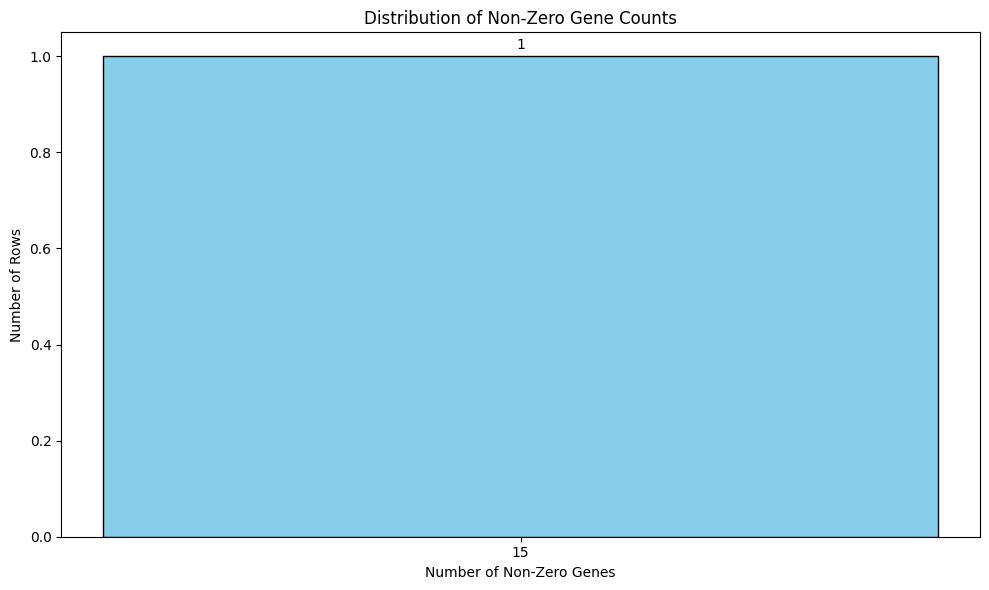

In [67]:
# Compute the full range of non-zero gene counts
min_count = df_children['nonzero_gene_count'].min()
max_count = df_children['nonzero_gene_count'].max()

# Tally how many rows have each non-zero gene count, 
# ensuring we include every integer in [min_count, max_count]
counts_by_nz = (
    df_children['nonzero_gene_count']
      .value_counts()
      .reindex(range(min_count, max_count + 1), fill_value=0)
      .sort_index()
)

# Plot a bar chart of the distribution with counts displayed
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(counts_by_nz.index, counts_by_nz.values, color='skyblue', edgecolor='black')

# Annotate each bar with its count
for bar in bars:
    height = bar.get_height()
    ax.annotate(
        f'{int(height)}',
        xy=(bar.get_x() + bar.get_width() / 2, height),
        xytext=(0, 3),            # small offset above the bar
        textcoords='offset points',
        ha='center',
        va='bottom'
    )

ax.set_xlabel('Number of Non-Zero Genes')
ax.set_ylabel('Number of Rows')
ax.set_title('Distribution of Non-Zero Gene Counts')
ax.set_xticks(counts_by_nz.index)  # show every count on the x-axis

plt.tight_layout()
plt.show()

In [68]:
smallest_dna = df_children[df_children['nonzero_gene_count'] == 14]
smallest_dna_list = list(smallest_dna.iloc[0][:len(ACTIVE_SYNAPSES)])
smallest_dna_list

IndexError: single positional indexer is out-of-bounds

In [70]:
 #CHECK RESULTS
run_experiment(sorted_results_pruned[0]['dna'],[1,1,1,0])

                    

Currently loaded matrix ---


,Somat,MSN1,SNR1,VMprep,ALMprep,MSN2,SNR2,PPN,THALgo,ALMinter,MSN3,SNR3,ALMresp,VMresp
Somat,0.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MSN1,0.0,0.0,-7.0,0.0,0.0,0.0,-42.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SNR1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-500.0
VMprep,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ALMprep,0.0,171.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MSN2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SNR2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
PPN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,29.0,0.0,0.0,0.0,0.0,0.0
THALgo,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,130.0,0.0,0.0,114.0,0.0
ALMinter,0.0,0.0,0.0,0.0,-55.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


734

And below here we have the graph...

In [75]:
# Calculate proportion of graphs with vector
# Calculate the number of DNAs

num_dnas = len(sorted_results_pruned)

# Determine which connections are shared by more than 50% of the DNAs
shared_connections = np.zeros(len(ACTIVE_SYNAPSES), dtype=int)

for item in sorted_results_pruned:
    shared_connections += np.array([1 if weight != 0 else 0 for weight in item['dna']])
    
connection_percentages = np.round(shared_connections/num_dnas*100,0)
cpl_full = [int(i) for i in connection_percentages]
cpl = [int(i) if i>=50 else 0 for i in connection_percentages]

labels = [f'{syn[0]}>>{syn[1]}' for syn in ACTIVE_SYNAPSES]
print(labels)
print(cpl_full)
print(cpl)

print("All synapses")
for label, prop in zip(labels,cpl_full):
    print(label, prop)
print("Major synapses")
for label, prop in zip(labels,cpl):
    print(label, prop)

['Somat>>ALMprep', 'Somat>>ALMinter', 'Somat>>ALMresp', 'ALMprep>>Somat', 'ALMinter>>Somat', 'ALMresp>>Somat', 'Somat>>MSN1', 'Somat>>MSN2', 'Somat>>MSN3', 'MSN1>>SNR1', 'MSN1>>SNR2', 'MSN1>>SNR3', 'MSN2>>SNR1', 'MSN2>>SNR2', 'MSN2>>SNR3', 'MSN3>>SNR1', 'MSN3>>SNR2', 'MSN3>>SNR3', 'SNR1>>VMprep', 'SNR1>>VMresp', 'SNR2>>VMprep', 'SNR2>>VMresp', 'SNR3>>VMprep', 'SNR3>>VMresp', 'VMprep>>ALMprep', 'VMprep>>ALMinter', 'VMprep>>ALMresp', 'VMresp>>ALMprep', 'VMresp>>ALMinter', 'VMresp>>ALMresp', 'ALMprep>>MSN1', 'ALMprep>>MSN2', 'ALMprep>>MSN3', 'ALMinter>>MSN1', 'ALMinter>>MSN2', 'ALMinter>>MSN3', 'ALMresp>>MSN1', 'ALMresp>>MSN2', 'ALMresp>>MSN3', 'ALMprep>>VMprep', 'ALMprep>>VMresp', 'ALMresp>>VMprep', 'ALMresp>>VMresp', 'MSN1>>MSN2', 'MSN1>>MSN3', 'MSN2>>MSN1', 'MSN2>>MSN3', 'MSN3>>MSN1', 'MSN3>>MSN2', 'ALMprep>>ALMinter', 'ALMprep>>ALMresp', 'ALMinter>>ALMprep', 'ALMinter>>ALMresp', 'ALMresp>>ALMprep', 'ALMresp>>ALMinter', 'PPN>>THALgo', 'THALgo>>ALMinter', 'THALgo>>ALMresp']
[100, 0, 0, 

In [76]:
print(len(cpl))
print(len(ACTIVE_SYNAPSES))

58
58


In [77]:
# Build connection labels from ACTIVE_SYNAPSES
labels = [f"{pre} -> {post}" for pre, post in ACTIVE_SYNAPSES]

# Define the two VM-specific connection keys
vm_keys = ["VMresp -> ALMresp", "VMprep -> ALMprep"]

# Extract the VM-specific percentages into a list
vm_list = [cpl[labels.index(key)] for key in vm_keys]

# Build the main connections list: zero out VM connections in the original cpl
cpl_list = [
    0 if lbl in vm_keys else val
    for lbl, val in zip(labels, cpl)
]

# Display the results
print("Main connections list (cpl_list):", cpl_list)
print("VM-specific connections list (vm_list):", vm_list)
print("Lengths:", len(cpl_list), len(vm_list), len(ACTIVE_SYNAPSES))


Main connections list (cpl_list): [100, 0, 0, 0, 0, 0, 0, 0, 0, 100, 100, 0, 0, 0, 0, 0, 0, 100, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 100, 100, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 100, 100, 100]
VM-specific connections list (vm_list): [100, 100]
Lengths: 58 2 58


Somat --4.0--> ALMprep. Original val: 100
MSN1 --4.0--> SNR1. Original val: 100
MSN1 --4.0--> SNR2. Original val: 100
MSN3 --4.0--> SNR3. Original val: 100
SNR1 --4.0--> VMresp. Original val: 100
ALMprep --4.0--> MSN1. Original val: 100
ALMresp --4.0--> MSN3. Original val: 100
ALMprep --4.0--> VMprep. Original val: 100
ALMresp --4.0--> VMresp. Original val: 100
ALMinter --4.0--> ALMprep. Original val: 100
PPN --4.0--> THALgo. Original val: 100
THALgo --4.0--> ALMinter. Original val: 100
THALgo --4.0--> ALMresp. Original val: 100


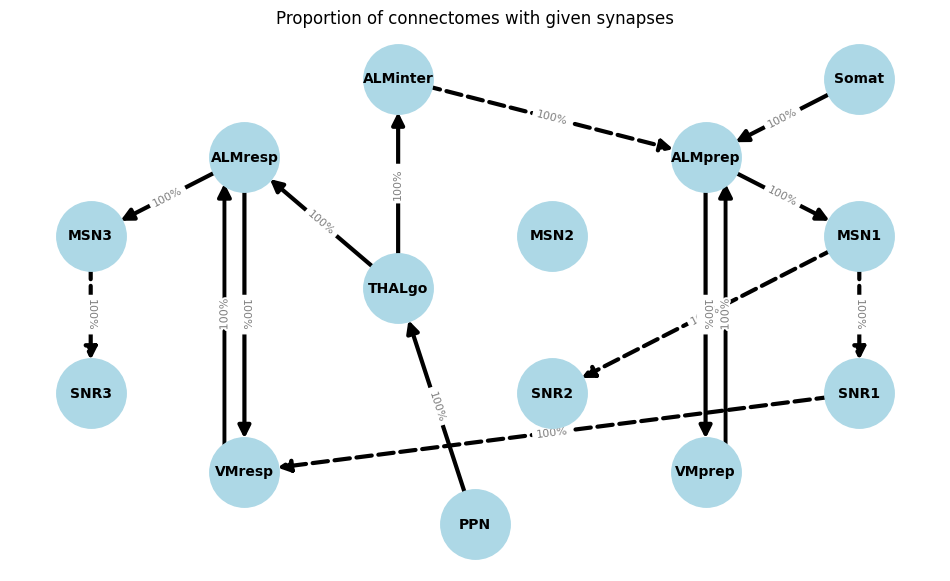

In [78]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import FancyArrowPatch
import matplotlib.patheffects as pe

# Define custom positions for each node
neu_coords = {
    'Somat': (5, 8.5),
    'MSN1': (5, 5.5),
    'MSN2': (3, 5.5),
    'MSN3': (0, 5.5),
    'SNR1': (5, 2.5),
    'SNR2': (3, 2.5),
    'SNR3': (0, 2.5),
    'ALMinter': (2, 8.5),
    'PPN': (2.5, 0),
    'THALgo': (2, 4.5),
    'VMprep': (4, 1),
    'ALMprep': (4, 7),
    'ALMresp': (1, 7),
    'VMresp': (1, 1)
}

# Create directed graph and add all neuron nodes
G = nx.DiGraph()
G.add_nodes_from(NEURON_NAMES)

# === Build the main synaptic edges from cpl_list ===
main_edges = []
edge_widths = []
edge_styles = []
for i, (u, v) in enumerate(ACTIVE_SYNAPSES):
    val = cpl_list[i]
    if val != 0:
        print(f'{u} --{np.ceil(val/30)}--> {v}. Original val: {val}')
        G.add_edge(u, v, weight=f'{val}%')
        main_edges.append((u, v))
        edge_widths.append(3)
        edge_styles.append('dashed' if u in INHIBITORY_NEURONS else 'solid')

# === Add two VM-specific edges with fixed 100% weight ===
vm_edges = [('VMresp', 'ALMresp'), ('VMprep', 'ALMprep')]
for u, v in vm_edges:
    G.add_edge(u, v, weight='100%')

# === Drawing ===
plt.figure(figsize=(12, 7))
ax = plt.gca()

# 1) Draw nodes and labels
nx.draw_networkx_nodes(G, pos=neu_coords, node_size=2500,
                       node_color='lightblue', ax=ax)
nx.draw_networkx_labels(G, pos=neu_coords, font_size=10,
                        font_weight='bold', ax=ax)

# 2) draw *all* main edges (solid & dashed) in one go – with arrow heads
nx.draw_networkx_edges(
    G, pos=neu_coords,
    edgelist=main_edges,
    width=edge_widths,
    style=edge_styles,          # list: 'solid' or 'dashed' per edge
    edge_color='black',
    arrowstyle='-|>',           # <<<  real arrow head
    arrowsize=18,               # tweaked size
    min_source_margin=20,       # keeps head from touching node
    min_target_margin=24,
    ax=ax,
    # zorder=0                    # draw below labels & custom patches
)

# ----------------------------------------------------------------------
# 3) Draw VM-specific edges as compact, parallel arrows with inline labels
# ----------------------------------------------------------------------
offset_dist   = 0.13   # push the two arrows further apart
label_offset  = 0.0   # push the '100 %' a bit off the arrow itself
head_size     = 20      # ≈ font-height – feels balanced
shaft_width   = 2.8
trim_ends     = 18.65     # makes arrow visibly shorter and keeps the head
                       # from touching the node boundary

for idx, (u, v) in enumerate(vm_edges):
    x1, y1 = neu_coords[u]
    x2, y2 = neu_coords[v]
    dx, dy = x2 - x1, y2 - y1
    length = np.hypot(dx, dy)

    # perpendicular unit-vector for left/right offset
    perp = np.array([-dy, dx]) / length if length else np.zeros(2)
    sign = 1 if idx % 2 == 0 else -1     # one edge above, the other below

    start = np.array([x1, y1]) + perp * offset_dist * sign
    end   = np.array([x2, y2]) + perp * offset_dist * sign

    # ---------- arrow ----------
    arrow = FancyArrowPatch(
        posA=start, posB=end,
        arrowstyle='-|>',
        mutation_scale=head_size,
        linewidth=shaft_width,
        shrinkA=trim_ends, shrinkB=trim_ends,
        color='black',
        zorder=1          # draw *below* the label
    )
    ax.add_patch(arrow)

    # ---------- label ----------
    label_offset  = -.1       # <-- set to zero for “inline”
    mid  = (start + end) / 2
    label_pos = mid                         # inline
    angle = np.degrees(np.arctan2(end[1] - start[1], end[0] - start[0]))

    ax.text(
        *label_pos, '100%',
        fontsize=8, color='gray',
        ha='center', va='center', rotation=angle, zorder=3,
        path_effects=[pe.withStroke(linewidth=3, foreground="white")]  # white halo
    )

# 4) Add edge labels for the non-VM edges
main_edge_labels = {
    edge: wt for edge, wt in nx.get_edge_attributes(G, 'weight').items()
    if edge not in vm_edges
}
nx.draw_networkx_edge_labels(
    G, pos=neu_coords,
    edge_labels=main_edge_labels,
    font_color='gray',
    font_size=8,
    rotate=True,
    ax=ax
)

plt.title('Proportion of connectomes with given synapses')
plt.axis('off')
plt.show()

Adding edges to graph:

Drawing nodes and labels...

Separating edge types...
  Found 11 non-reciprocal edges.
  Found 2 reciprocal pairs.

Drawing non-reciprocal edges...

Drawing reciprocal edges (manual parallel)...

Drawing edge labels...
  Drawing 11 non-reciprocal labels...

  Drawing 4 reciprocal labels (manual)...


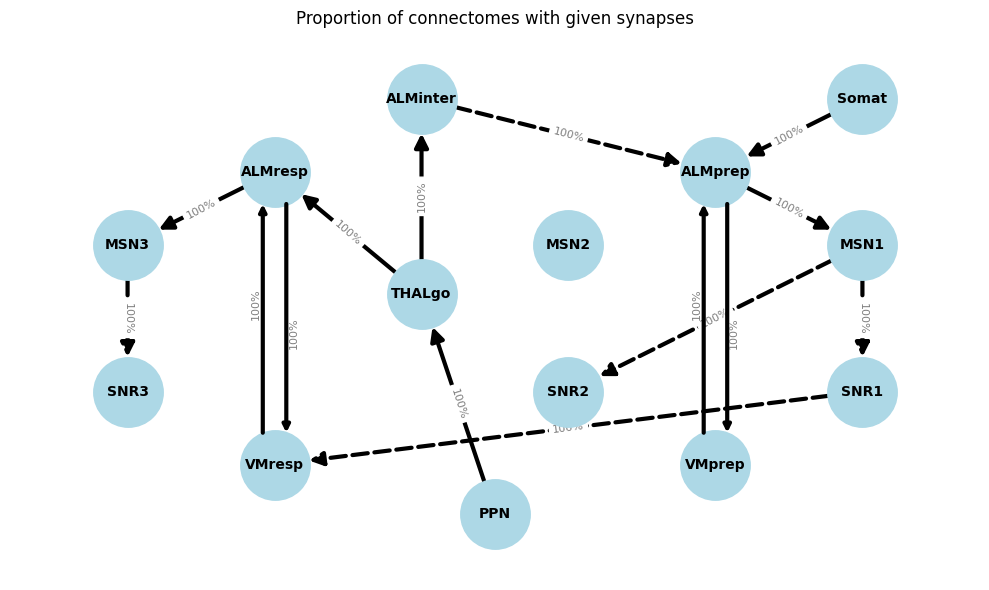

In [79]:
# Version 2
# Create a graph
G = nx.DiGraph()

# Add nodes for each neuron
G.add_nodes_from(NEURON_NAMES)

# Add edges with attributes (weight, style, width) for non-zero connections
print("Adding edges to graph:")
# Ensure lengths match if using separate lists originally
if len(cpl) != len(ACTIVE_SYNAPSES):
     raise ValueError("Length mismatch between cpl and ACTIVE_SYNAPSES")

for i in range(len(cpl)):
    val = cpl[i]
    u, v = ACTIVE_SYNAPSES[i]

    # Basic check for validity
    if u not in NEURON_NAMES or v not in NEURON_NAMES:
        print(f"Warning: Skipping edge {u}->{v}. Node not defined in NEURON_NAMES.")
        continue

    if val != 0:
        # Determine style based on source neuron
        style = 'dashed' if u in INHIBITORY_NEURONS else 'solid'
        # Define width (e.g., constant or based on val)
        width = 3 # Example fixed width, adjust as needed
        weight_label = f'{val}%'

        # Add edge with all relevant data as attributes
        G.add_edge(u, v, weight=weight_label, style=style, width=width)
        # Optional print statement from original code:
        # print(f'{u} --{np.ceil(val / 30)}--> {v}. Original val: {val}')

# --- Drawing Logic (Replaces the single nx.draw call) ---
plt.figure(figsize=(10, 6)) # Adjusted figure size
ax = plt.gca() # Get axes for drawing

# 1. Draw nodes and node labels
print("\nDrawing nodes and labels...")
nx.draw_networkx_nodes(G, pos=neu_coords, node_size=2500, node_color='lightblue', ax=ax)
nx.draw_networkx_labels(G, pos=neu_coords, font_size=10, font_weight='bold', ax=ax)

# 2. Separate edges into reciprocal and non-reciprocal
print("\nSeparating edge types...")
reciprocal_edges_pairs = set()
non_reciprocal_edges_data = [] # Store tuples (u, v, data)
all_edges_with_data = list(G.edges(data=True))

for u, v, data in all_edges_with_data:
    if G.has_edge(v, u):
        pair = tuple(sorted((u, v)))
        reciprocal_edges_pairs.add(pair) # Store unique pairs
    else:
        non_reciprocal_edges_data.append((u, v, data))
print(f"  Found {len(non_reciprocal_edges_data)} non-reciprocal edges.")
print(f"  Found {len(reciprocal_edges_pairs)} reciprocal pairs.")


# --- 3. Draw Edges ---

# 3a. Draw non-reciprocal edges (using NetworkX draw_networkx_edges)
if non_reciprocal_edges_data:
    print(f"\nDrawing non-reciprocal edges...")
    edgelist_nr = [(u, v) for u, v, data in non_reciprocal_edges_data]
    # Retrieve styles and widths *from edge attributes*
    styles_nr = [data['style'] for u, v, data in non_reciprocal_edges_data]
    widths_nr = [data['width'] for u, v, data in non_reciprocal_edges_data]
    nx.draw_networkx_edges(G, pos=neu_coords, edgelist=edgelist_nr,
                           node_size=2500, # Match node size
                           arrowstyle='-|>', arrowsize=20, # User's original arrowsize
                           edge_color='black',
                           width=widths_nr, # Use specific widths
                           style=styles_nr, # Use specific styles
                           connectionstyle='arc3,rad=0', ax=ax) # Straight line

# 3b. Draw reciprocal edges MANUALLY as offset parallel lines
if reciprocal_edges_pairs:
    print(f"\nDrawing reciprocal edges (manual parallel)...")
    # --- Parameters to TUNE for parallel lines ---
    parallel_offset = 0.08  # Increased offset slightly
    shorten_length = 0.6 # Increased shortening slightly (adjust based on node_size=2000)

    for u_orig, v_orig in reciprocal_edges_pairs:
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])

        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue
        unit_vec = vec / vec_len
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        start_node_adj = unit_vec * shorten_length
        end_node_adj = unit_vec * shorten_length

        # Arrow 1: u -> v (offset by +perp_vec)
        start1 = pos_u + start_node_adj + perp_vec * parallel_offset
        end1   = pos_v - end_node_adj   + perp_vec * parallel_offset
        edge_data_uv = G.get_edge_data(u_orig, v_orig)
        style_uv = edge_data_uv.get('style', 'solid')
        width_uv = edge_data_uv.get('width', 2) # Use default width if not found
        ls_uv = '--' if style_uv == 'dashed' else '-'
        ax.annotate("", xy=end1, xycoords='data', xytext=start1, textcoords='data',
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    linestyle=ls_uv, linewidth=width_uv))

        # Arrow 2: v -> u (offset by -perp_vec)
        start2 = pos_v - start_node_adj - perp_vec * parallel_offset
        end2   = pos_u + end_node_adj   - perp_vec * parallel_offset
        edge_data_vu = G.get_edge_data(v_orig, u_orig)
        style_vu = edge_data_vu.get('style', 'solid')
        width_vu = edge_data_vu.get('width', 2)
        ls_vu = '--' if style_vu == 'dashed' else '-'
        ax.annotate("", xy=end2, xycoords='data', xytext=start2, textcoords='data',
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    linestyle=ls_vu, linewidth=width_vu))

# --- 4. Draw Labels ---
print("\nDrawing edge labels...")
all_edge_labels = nx.get_edge_attributes(G, 'weight')

# 4a. Draw labels for non-reciprocal edges
labels_nr = {}
for u, v, data in non_reciprocal_edges_data:
    edge_tuple = (u, v)
    if edge_tuple in all_edge_labels:
         labels_nr[edge_tuple] = all_edge_labels[edge_tuple]
if labels_nr:
     print(f"  Drawing {len(labels_nr)} non-reciprocal labels...")
     nx.draw_networkx_edge_labels(G, pos=neu_coords, edge_labels=labels_nr,
                                 label_pos=0.5, rotate=True, # Use networkx rotation
                                 font_color='gray', font_size=8, # User's original font
                                 bbox=None, # No background box
                                 ax=ax)

# 4b. Draw labels for reciprocal edges MANUALLY
if reciprocal_edges_pairs:
    print(f"\n  Drawing {len(reciprocal_edges_pairs)*2} reciprocal labels (manual)...")
    # --- Parameters for TUNE for label placement ---
    label_pos_factor = 0.55 # Position along the line (0.5=mid)
    label_perp_offset = parallel_offset * 1.6 # Perpendicular offset

    for u_orig, v_orig in reciprocal_edges_pairs:
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])
        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue
        unit_vec = vec / vec_len
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        angle_rad = np.arctan2(vec[1], vec[0])
        angle_deg = np.degrees(angle_rad)
        if 90 < angle_deg <= 180: angle_deg -= 180
        if -180 < angle_deg <= -90: angle_deg += 180

        common_text_args = dict(ha='center', va='center', rotation=angle_deg,
                                rotation_mode='anchor',
                                color='gray', size=8) # Match user's font style

        # Label 1: u -> v
        label_uv_val = all_edge_labels.get((u_orig, v_orig))
        if label_uv_val:
             label_pos1 = pos_u + unit_vec * vec_len * label_pos_factor + perp_vec * label_perp_offset
             ax.text(label_pos1[0], label_pos1[1], label_uv_val, **common_text_args)

        # Label 2: v -> u
        label_vu_val = all_edge_labels.get((v_orig, u_orig))
        if label_vu_val:
             label_pos2 = pos_v - unit_vec * vec_len * label_pos_factor - perp_vec * label_perp_offset
             ax.text(label_pos2[0], label_pos2[1], label_vu_val, **common_text_args)


# --- Final Plotting ---
plt.title('Proportion of connectomes with given synapses')
plt.axis('off') # Hide axes
plt.tight_layout() # Adjust layout
plt.margins(0.1) # Add margins
plt.show()

In [ ]:
#

Adjusting potentially duplicate reciprocal definitions...
Adding edges:
  Adding: Somat --(95%, solid)--> MSN1
  Adding: MSN1 --(85%, dashed)--> SNR1
  Adding: MSN2 --(67%, dashed)--> SNR2
  Adding: MSN3 --(57%, dashed)--> SNR3
  Adding: ALMinter --(94%, solid)--> ALMprep
  Adding: ALMprep --(95%, solid)--> MSN2
  Adding: ALMprep --(100%, solid)--> SNR2
  Adding: ALMprep --(100%, solid)--> Somat
  Adding: THALgo --(95%, solid)--> ALMinter
  Adding: THALgo --(100%, solid)--> ALMresp
  Adding: PPN --(100%, solid)--> THALgo
  Adding: ALMresp --(90%, solid)--> MSN3
  Adding: ALMresp --(100%, solid)--> VMresp
  Adding: VMresp --(98%, solid)--> PPN
  Adding: ALMprep --(74%, solid)--> VMprep
  Adding: VMprep --(70%, solid)--> ALMprep
  Adding: VMresp --(80%, solid)--> ALMresp
Adding edges:

Separating edge types:
  Found reciprocal pair: ('ALMprep', 'VMprep')
  Found reciprocal pair: ('ALMresp', 'VMresp')

Drawing 13 non-reciprocal edges...

Drawing 4 reciprocal edges (manual parallel)...
  D

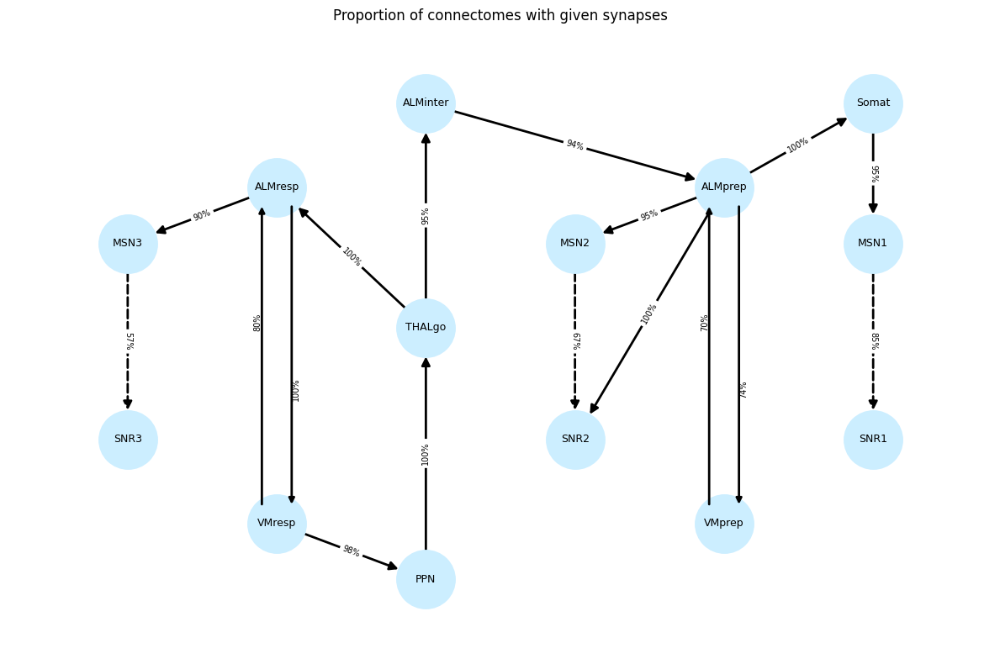

In [54]:
# version 3
cpl_values = {
    ('Somat', 'MSN1'): 95, ('MSN1', 'SNR1'): 85, ('MSN2', 'SNR2'): 67,
    ('MSN3', 'SNR3'): 57, ('ALMinter', 'ALMprep'): 94, ('ALMprep', 'MSN2'): 95,
    ('ALMprep', 'SNR2'): 100, ('ALMprep', 'Somat'): 100, ('THALgo', 'ALMinter'): 95,
    ('THALgo', 'ALMresp'): 100, ('PPN', 'THALgo'): 100, ('ALMresp', 'MSN3'): 90,
    ('ALMresp', 'VMresp'): 100, ('VMresp', 'PPN'): 98, # Assuming 98% from image
    # --- RECIPROCAL PAIRS ---
    ('ALMprep', 'VMprep'): 74, # Example value, check your real data
    ('VMprep', 'ALMprep'): 70, # Example value, check your real data
    ('VMresp', 'ALMresp'): 80, # Example value, check your real data
    # Note: ('ALMresp', 'VMresp') = 100% is already defined above.
    # The LAST definition in the dict for a key wins. Ensure you have the correct % for each direction.
    # Let's assume ALMresp -> VMresp is 100%, and VMresp -> ALMresp is 80%
}
# Correct the potential duplicate key issue
if ('ALMresp', 'VMresp') in cpl_values and ('VMresp', 'ALMresp') in cpl_values:
     print("Adjusting potentially duplicate reciprocal definitions...")
     # Keep the explicitly defined values if they exist
     # Example: Keep ALMresp->VMresp = 100, VMresp->ALMresp = 80
     # No code change needed if the dict is built correctly like above.

ACTIVE_SYNAPSES = list(cpl_values.keys())
cpl = list(cpl_values.values())
INHIBITORY_NEURONS = {'MSN1', 'MSN2', 'MSN3', 'SNR1', 'SNR2', 'SNR3'} # Assuming SNRs are inhibitory targets/sources based on dashes

# Create graph and add nodes
G = nx.DiGraph()
G.add_nodes_from(NEURON_NAMES)

# Add edges with attributes
print("Adding edges:")
for i in range(len(cpl)):
    val = cpl[i]
    if val != 0 and i < len(ACTIVE_SYNAPSES):
        u, v = ACTIVE_SYNAPSES[i]
        if u in NEURON_NAMES and v in NEURON_NAMES:
            # Determine style (Example: based on source neuron)
            style = 'dashed' if u in INHIBITORY_NEURONS else 'solid'
             # Or check target: style = 'dashed' if v in INHIBITORY_NEURONS else 'solid'
            width = 2
            weight_label = f'{val}%'
            print(f'  Adding: {u} --({weight_label}, {style})--> {v}')
            G.add_edge(u, v, weight=weight_label, style=style, width=width)
        else:
            print(f"Skipping edge {u}->{v}: Node(s) not in NEURON_NAMES")
print("Adding edges:")
for i in range(len(cpl)):
    val = cpl[i]
    if val != 0 and i < len(ACTIVE_SYNAPSES):
        u, v = ACTIVE_SYNAPSES[i]
        if u in NEURON_NAMES and v in NEURON_NAMES:
            style = 'dashed' if u in INHIBITORY_NEURONS else 'solid'
            width = 2
            weight_label = f'{val}%'
            #print(f'  Adding: {u} --({weight_label}, {style})--> {v}') # Less verbose
            G.add_edge(u, v, weight=weight_label, style=style, width=width)
        #else: print(f"Skipping edge {u}->{v}: Node(s) not found") # Optional warning

# --- Drawing Logic ---
plt.figure(figsize=(12, 8))
ax = plt.gca()

# Draw nodes and node labels
nx.draw_networkx_nodes(G, pos=neu_coords, node_size=2500, node_color='#cceeff', ax=ax)
nx.draw_networkx_labels(G, pos=neu_coords, font_size=9, font_weight='normal', ax=ax)

# Separate edges
reciprocal_edges_pairs = set()
non_reciprocal_edges_data = []
all_edges_with_data = list(G.edges(data=True))

print("\nSeparating edge types:")
for u, v, data in all_edges_with_data:
    if G.has_edge(v, u):
        pair = tuple(sorted((u, v)))
        if pair not in reciprocal_edges_pairs:
             print(f"  Found reciprocal pair: {pair}")
             reciprocal_edges_pairs.add(pair)
    else:
        #print(f"  Found non-reciprocal edge: ({u}, {v})") # Less verbose
        non_reciprocal_edges_data.append((u, v, data))


# --- Draw Edges ---

# 1. Draw non-reciprocal edges (using NetworkX draw_networkx_edges)
if non_reciprocal_edges_data:
    print(f"\nDrawing {len(non_reciprocal_edges_data)} non-reciprocal edges...")
    edgelist_nr = [(u, v) for u, v, data in non_reciprocal_edges_data]
    styles_nr = [data['style'] for u, v, data in non_reciprocal_edges_data]
    widths_nr = [data['width'] for u, v, data in non_reciprocal_edges_data]
    nx.draw_networkx_edges(G, pos=neu_coords, edgelist=edgelist_nr, node_size=2500,
                           arrowstyle='-|>', arrowsize=15, edge_color='black',
                           width=widths_nr, style=styles_nr,
                           connectionstyle='arc3,rad=0', ax=ax) # Straight line

# 2. Draw reciprocal edges MANUALLY as offset parallel lines
if reciprocal_edges_pairs:
    print(f"\nDrawing {len(reciprocal_edges_pairs)*2} reciprocal edges (manual parallel)...")
    # --- Parameters for parallel lines ---
    parallel_offset = 0.1  # Controls separation distance (in data coords, adjust)
    # Amount to shorten arrows to avoid drawing inside nodes (depends on node size/scale)
    # This value might need tuning based on your node_size and coordinate ranges
    shorten_length = 0.3 # Shorten each end by this amount (in data coords)

    for u_orig, v_orig in reciprocal_edges_pairs: # u_orig, v_orig are alphabetically sorted
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])

        # Calculate direction & perpendicular vectors
        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue # Avoid division by zero
        unit_vec = vec / vec_len
        # Normalized perpendicular vector
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        # Calculate start/end points, adjusted for shortening and offset
        # Arrow 1: u -> v (offset by +perp_vec)
        start1 = pos_u + unit_vec * shorten_length + perp_vec * parallel_offset
        end1   = pos_v - unit_vec * shorten_length + perp_vec * parallel_offset

        edge_data_uv = G.get_edge_data(u_orig, v_orig)
        style_uv = edge_data_uv.get('style', 'solid')
        width_uv = edge_data_uv.get('width', 1)
        ls_uv = '--' if style_uv == 'dashed' else '-' # Map to matplotlib linestyle

        print(f"  Drawing Arrow {u_orig} -> {v_orig} (parallel +)")
        ax.annotate("", xy=end1, xycoords='data', # End point coordinates
                    xytext=start1, textcoords='data', # Start point coordinates
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    # connectionstyle='arc3' means straight line here
                                    linestyle=ls_uv, linewidth=width_uv))

        # Arrow 2: v -> u (offset by -perp_vec)
        start2 = pos_v - unit_vec * shorten_length - perp_vec * parallel_offset # Start from v
        end2   = pos_u + unit_vec * shorten_length - perp_vec * parallel_offset # End at u

        edge_data_vu = G.get_edge_data(v_orig, u_orig)
        style_vu = edge_data_vu.get('style', 'solid')
        width_vu = edge_data_vu.get('width', 1)
        ls_vu = '--' if style_vu == 'dashed' else '-'

        print(f"  Drawing Arrow {v_orig} -> {u_orig} (parallel -)")
        ax.annotate("", xy=end2, xycoords='data',
                    xytext=start2, textcoords='data',
                    arrowprops=dict(arrowstyle='-|>', color='black',
                                    linestyle=ls_vu, linewidth=width_vu))

# --- Draw Labels ---
print("\nDrawing edge labels...")
all_edge_labels = nx.get_edge_attributes(G, 'weight')

# 1. Draw labels for non-reciprocal edges (using NetworkX function)
labels_nr = {}
for u, v, data in non_reciprocal_edges_data:
    edge_tuple = (u, v)
    if edge_tuple in all_edge_labels:
         labels_nr[edge_tuple] = all_edge_labels[edge_tuple]
if labels_nr:
     print(f"  Drawing {len(labels_nr)} non-reciprocal labels...")
     nx.draw_networkx_edge_labels(G, pos=neu_coords, edge_labels=labels_nr,
                                 label_pos=0.5, rotate=True, # Use networkx rotation
                                 font_color='black', font_size=7, bbox=None, ax=ax)

# 2. Draw labels for reciprocal edges MANUALLY
if reciprocal_edges_pairs:
    print(f"\n  Drawing {len(reciprocal_edges_pairs)*2} reciprocal labels (manual parallel)...")
    # --- Parameters for label placement ---
    # Position along the line (0.0=start, 0.5=mid, 1.0=end)
    label_pos_factor = 0.6
    # Perpendicular offset for labels (relative to center line)
    # Should be similar to arrow offset, maybe slightly more for clearance
    label_perp_offset = parallel_offset * 1.3

    for u_orig, v_orig in reciprocal_edges_pairs:
        pos_u = np.array(neu_coords[u_orig])
        pos_v = np.array(neu_coords[v_orig])
        vec = pos_v - pos_u
        vec_len = np.linalg.norm(vec)
        if vec_len < 1e-6: continue
        unit_vec = vec / vec_len
        perp_vec = np.array([-unit_vec[1], unit_vec[0]])

        # Calculate edge angle for text rotation
        angle_rad = np.arctan2(vec[1], vec[0])
        angle_deg = np.degrees(angle_rad)
        # Correct angle to prevent upside-down text
        if 90 < angle_deg <= 180: angle_deg -= 180
        if -180 < angle_deg <= -90: angle_deg += 180

        common_text_args = dict(ha='center', va='center', rotation=angle_deg,
                                rotation_mode='anchor', color='black', size=7)

        # Label 1: u -> v (associated with +perp_vec offset arrow)
        label_uv_val = all_edge_labels.get((u_orig, v_orig))
        if label_uv_val:
             # Calculate position: point along original vector + perpendicular offset
             label_pos1 = pos_u + unit_vec * vec_len * label_pos_factor + perp_vec * label_perp_offset
             print(f"    Label {u_orig}->{v_orig}: '{label_uv_val}' at {np.round(label_pos1, 2)}")
             ax.text(label_pos1[0], label_pos1[1], label_uv_val, **common_text_args)

        # Label 2: v -> u (associated with -perp_vec offset arrow)
        label_vu_val = all_edge_labels.get((v_orig, u_orig))
        if label_vu_val:
             # Calculate position relative to V, going towards U, offset opposite way
             label_pos2 = pos_v - unit_vec * vec_len * label_pos_factor - perp_vec * label_perp_offset
             print(f"    Label {v_orig}->{u_orig}: '{label_vu_val}' at {np.round(label_pos2, 2)}")
             ax.text(label_pos2[0], label_pos2[1], label_vu_val, **common_text_args)


plt.title('Proportion of connectomes with given synapses')
plt.axis('off')
plt.tight_layout() # Adjust layout
plt.margins(0.1) # Add some margins
plt.show()
